**<h1><center>CHINESE CUBE</center></h1>**
<h3><center>A pythonic solution to the 3D chinese wooden puzzle</center></h3>
<h4><center> Created by: <b>Francesco Rambaldi</b> & <b>Giacomo Berselli</b></center></h>
<br>
<center><img src="https://docs.google.com/uc?export=download&id=18u3dBH9-o-bl4ieiwIPnRQQl4UdtGZrJ" width = "400px"/><center>


# <b>Block Combinations</b>

In this section we generate all the possible block combinations (possible ways in which we can arrange the blocks). For each one of these combinations we will check if it is a solution.

In order to distinguish the blocks, we labeled each of them with two letters: in particular every block has one side marked with a lowercase letter and the opposite side marked with the same letter, but uppercase.

<br>
<table><tr><td><img src='https://docs.google.com/uc?export=download&id=1eqsNSor9PN_aVWopubdSZFh5flfdQuVx'></td><td><img src='https://docs.google.com/uc?export=download&id=1YXKSMctdIgAEgn65qR36YzCeakICkwto'></td><td><img src='https://docs.google.com/uc?export=download&id=1rXzSq6spgunoAP3TZLU5LkFZ4OnnyUYE'></td><td><img src='https://docs.google.com/uc?export=download&id=1w_lL-lmfsfbGVqyi8NvtU2Micz8Pk2c5'></tr><td><img src='https://docs.google.com/uc?export=download&id=1nwHGJ50zJX4QZtskbwZ8sawuyZrqorcN'></td><td><img src='https://docs.google.com/uc?export=download&id=1nClWA_zWX72BnWLfUXG6ffqSdDJbZ3hq'></td><td><img src='https://docs.google.com/uc?export=download&id=1wYJLJqmGDhINuFuCghRHmD4IdUmk3nm6'></td><td><img src='https://docs.google.com/uc?export=download&id=1TQHlgRyFF7QXU77jB6gf8n0ZG0g8T3mU'></tr><td><img src='https://docs.google.com/uc?export=download&id=1ZChd0LLTCZk-FI3c-DIlmFnqz1WIk4Bf'></td><td><img src='https://docs.google.com/uc?export=download&id=181gXx0U7vjsM1TW9LjzMwCEc1l5SKy6z'></td><td><img src='https://docs.google.com/uc?export=download&id=1BrGO_K5-ZqorNQ1X6L6LwqypK-ozBZla'></td><td><img src='https://docs.google.com/uc?export=download&id=1bDXHbcqjq5gHraEtDUMwXYel82gGyiiz'></td></tr></table>

In [1]:
#@title Compute All Combinations { form-width: "30%" }

from itertools import permutations  
from itertools import combinations 
import copy

perm = list(map(list,permutations(["a", "b", "c", "d", "e", "f"])))
final = copy.copy(perm)
comb_1 = list(map(list,combinations(["a", "b", "c", "d", "e", "f"], 1)))
comb_2 = list(map(list,combinations(["a", "b", "c", "d", "e", "f"], 2)))
comb_3 = list(map(list,combinations(["a", "b", "c", "d", "e", "f"], 3)))
comb_4 = list(map(list,combinations(["a", "b", "c", "d", "e", "f"], 4)))
comb_5 = list(map(list,combinations(["a", "b", "c", "d", "e", "f"], 5)))
comb_6 = list(map(list,combinations(["a", "b", "c", "d", "e", "f"], 6)))
combs = [comb_1, comb_2, comb_3, comb_4, comb_5, comb_6]
for el in perm:
    for comb_n in combs:
        for comb in comb_n:
            l = copy.copy(el)
            for lowercase in comb:
                idx = l.index(lowercase) 
                l[idx] = l[idx].upper()      
            final.append(l)

print(f"The total number of combinations is {len(final)}")

The total number of combinations is 46080


# <b>Blocks as 3D Matrices</b>

In this section we create the 6 blocks as 3D numpy arrays and a useful visualization function to plot the results. We also combine the blocks together in a single 3D numpy array

In [2]:
#@title Plot Function { form-width: "30%" }

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 
import numpy as np

def plot(piece_1, piece_2):
    """
    Given two pieces, create and show a 3-Dimensional plot.
    
    Input:
      - piece_1: 3D matrix of the first piece (numpy array)
      - piece_2: 3D matrix of the second piece (numpy array)
    """

    # set the colors and transparency of each object
    colors_piece_1 = np.empty(piece_1.shape + (4,))
    colors_piece_2 = np.empty(piece_2.shape + (4,))
    alpha = .5
    colors_piece_1[piece_1] = [0,0,1,alpha]
    colors_piece_2[piece_2] = [1,0,0,alpha]

    # and plot everything
    fig = plt.figure(figsize=(20,10))
    ax = fig.add_subplot(1, 2, 1, projection='3d')
    ax_2 = fig.add_subplot(1, 2, 2, projection='3d')
    ax.voxels(piece_1, facecolors=colors_piece_1, edgecolor='k')
    ax_2.voxels(piece_2, facecolors=colors_piece_2, edgecolor='k')

    plt.show() 

In [3]:
#@title Blocks As 3D Matrices { form-width: "30%" }

# prepare some coordinates
x, y, z = np.indices((2, 8, 4))

# A
A = (z < 2) | (y == 0) | ((y == 3) & (x == 1)) | (y == 7)
# Block "a" is the rotated version of block "A" (180 degree rotation with respect to z axis)
a = np.flip(np.flip(A,0),1) 

# B and b
B = (z < 2) | (y < 2) | (y > 5) | ((x == 1) & (y == 2)) | ((x == 1) & (y == 5)) 
b = np.flip(np.flip(B,0),1)

# C and c
C = (z < 2) | (y == 0) |  (y == 7) | ((x == 0) & ((y == 1) | (y == 3) | (y == 6))) 
c = np.flip(np.flip(C,0),1)

# D and d
D = (z < 2) | (y > 5) |  (y == 0) | ((x == 0) & ((y == 1) | (y == 3))) 
d = np.flip(np.flip(D,0),1)

# E and e
E = (z < 2) | (y < 2) |  (y == 7) | ((x == 1) & ((y != 5))) 
e = np.flip(np.flip(E,0),1)

# F and f
F = (z < 2) | (y < 2) |  (y == 7) | ((x == 0) & ((y != 5) & (y != 6)))
f = np.flip(np.flip(F,0),1)

Let's plot a block and its rotated version:

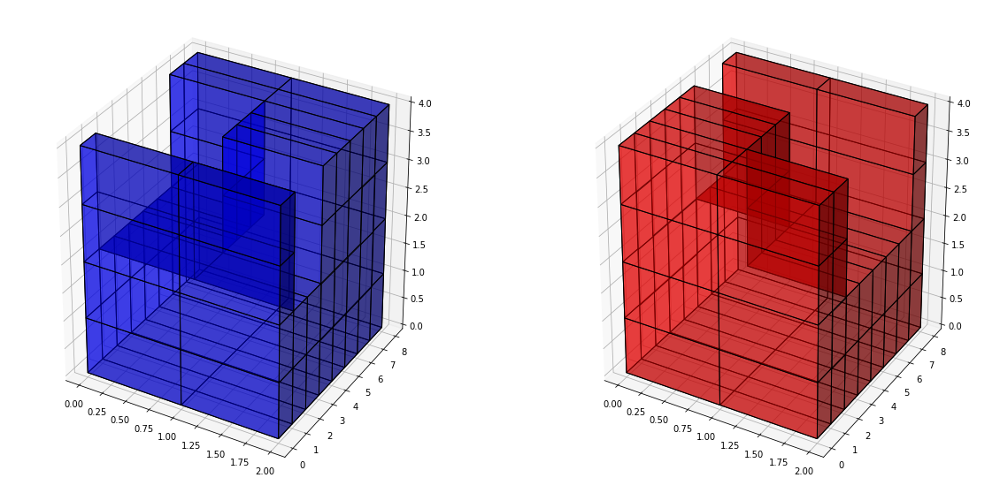

In [4]:
#@title Plot One Block { form-width: "30%" }

plot(f, F)

In [5]:
#@title Block To Array Dict { form-width: "30%" }

# Creating a correspondence between block names (as strings) and the actual numpy arrays
letter_to_piece = {"a": a, "b": b, "c": c, "d": d, "e": e, "f": f,
                   "A": A, "B": B, "C": C, "D": D, "E": E, "F": F}

Now we join together the three bottom blocks and the three top blocks:

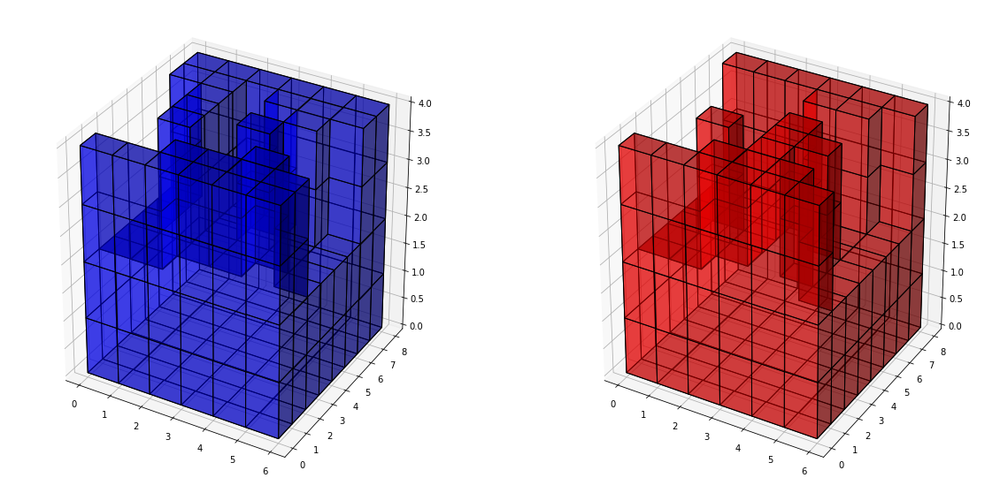

In [6]:
#@title Create Bottom and Top { form-width: "30%" }

configuration = ["f","d","b","A","E","C"]  # this is one possible combination of blocks
bottom = configuration[:3]
top = configuration[3:]
pieces_bottom = []
for el in bottom:
    pieces_bottom.append(letter_to_piece[el])
bottom = np.vstack((pieces_bottom[0], pieces_bottom[1], pieces_bottom[2]))
pieces_top = []
for el in top:
    pieces_top.append(letter_to_piece[el])
top = np.vstack((pieces_top[0], pieces_top[1], pieces_top[2]))

plot(bottom, top)

In order to test if a given combination of blocks is actually a solution, we need to check if, after turning upside down and rotating of 90 degrees the top configuration (which is the one on the right in the plot above), the bottom and top can fit well together

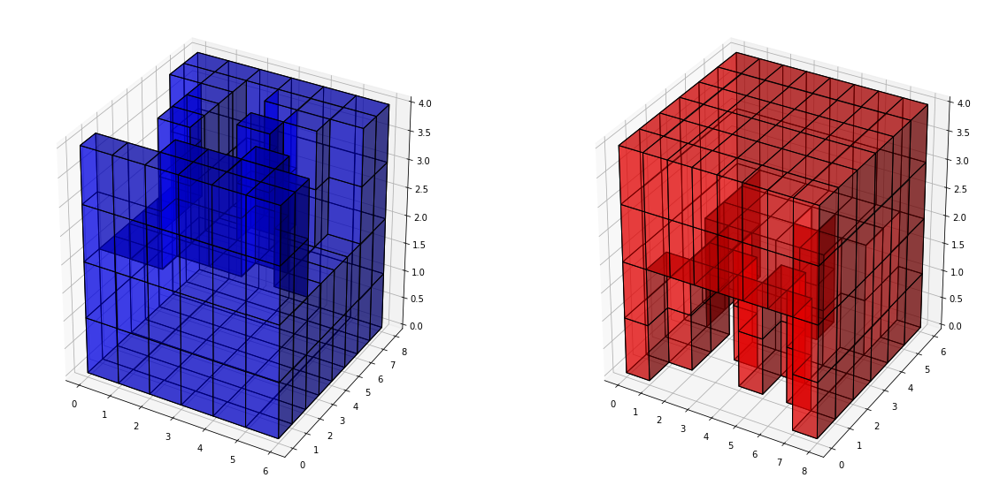

In [7]:
#@title Flip And Rotate { form-width: "30%" }

top_flipped = np.flip(np.flip(top,1),2)
top_flipped_rotated = np.rot90(top_flipped, k=1, axes=(1, 0))

plot(bottom, top_flipped_rotated)

# <b>Candidate Solutions Generation</b>

In this section we generate all the possible candidate solutions. 
<br>
We call these intermediate solutions "candidate", because only some of them will be actually solutions of the puzzle. Indeed, here we are working without taking into consideration the outer box, but just trying to overlap the bottom and top. These two components have to fit together in order to have a final solution of the puzzle (this is a necessary but not sufficient condition).
After this step, we will focus only on the configurations leading to candidate solutions, and we will discard all the other ones, because in those cases the necessary condition to find a final full solution will not be satisfied

The configuration ['f', 'd', 'b', 'A', 'E', 'C'] is a candidate solution. Let's plot it!



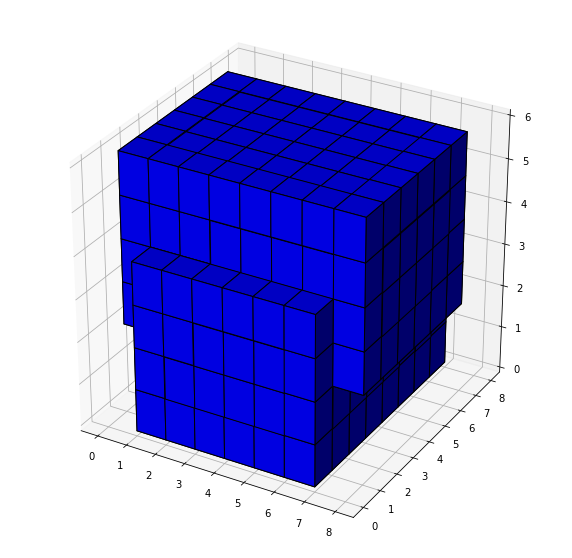

In [8]:
#@title Fit Together Bottom and Top { form-width: "30%" }

# In this cell we try to fit together the bottom and top of a single solution

zeros = np.zeros((8,8,6), dtype = int)  # creation of an empty 3D space
zeros[1:-1,:,0:-2] = zeros[1:-1,:,0:-2] + bottom 
zeros[:,1:-1,2:] = zeros[:,1:-1,2:] + top_flipped_rotated
candidate_sol = zeros

# if there is a "2" in the candidate_sol numpy array, it means that two blocks 
# are colliding (so the given configuration is NOT a candidate solution)
if 2 in candidate_sol:
    print(f"The configuration {configuration} is NOT a candidate solution")
else: 
    print(f"The configuration {configuration} is a candidate solution. Let's plot it!")
    print()
    candidate_sol = candidate_sol.astype(bool)
    colors_candidate_sol = np.empty(candidate_sol.shape, dtype=object)
    colors_candidate_sol[candidate_sol] = "blue"
    fig = plt.figure(figsize=(10,10))
    ax = fig.gca(projection='3d')
    ax.voxels(candidate_sol, facecolors=colors_candidate_sol, edgecolor='k')

    plt.show()

Now that we know how we can check if a configuration is a candidate solution, let's iterate and apply this approach to all the configurations

In [9]:
#@title Candidate Solutions Generation { form-width: "30%" }

solutions = []
for configuration in final:
    bottom = configuration[:3]
    top = configuration[3:]
    pieces_bottom = []
    for el in bottom:
        pieces_bottom.append(letter_to_piece[el])
    # stack together the 3 bottom blocks
    bottom = np.vstack((pieces_bottom[0], pieces_bottom[1], pieces_bottom[2]))
    pieces_top = []
    for el in top:
        pieces_top.append(letter_to_piece[el])
    # stack together the 3 top blocks
    top = np.vstack((pieces_top[0], pieces_top[1], pieces_top[2]))
    # flip and rotate the top
    top_flipped = np.flip(np.flip(top,1),2)
    top_flipped_rotated = np.rot90(top_flipped, k=1, axes=(1, 0))
    # create an empty space and try to fit together bottom and top
    zeros = np.zeros((8,8,6), dtype = int)
    zeros[1:-1,:,0:-2] = zeros[1:-1,:,0:-2] + bottom 
    zeros[:,1:-1,2:] = zeros[:,1:-1,2:] + top_flipped_rotated
    candidate_sol = zeros
    if 2 not in candidate_sol:  # SOL FOUND!
        solutions.append(configuration)

print(f"The number of candidate solutions found is: {len(solutions)}")

The number of candidate solutions found is: 392


By looking to the puzzle, we can easily see that we have one major simmetry: in fact, if we flip bottom and top we obtain a symmetric (equivalent) solution. Due to this fact, actually one half of the found candidate solutions are just symmetric, thus we can discard them

In [10]:
#@title Symmetry Breaking { form-width: "30%" }

# removing symmetric solutions
for el in solutions:
    to_check = el[3:] + el[:3]
    if to_check in solutions:
        solutions.remove(to_check)
print(f"The number of unique candidate solutions is: {len(solutions)}")

The number of unique candidate solutions is: 196


In [11]:
#@title Display Candidate Solutions { form-width: "30%" }

print(solutions)

[['a', 'c', 'b', 'f', 'd', 'e'], ['a', 'c', 'e', 'f', 'd', 'b'], ['a', 'd', 'b', 'f', 'c', 'e'], ['a', 'd', 'e', 'f', 'c', 'b'], ['a', 'f', 'b', 'c', 'd', 'e'], ['a', 'f', 'e', 'c', 'd', 'b'], ['c', 'a', 'b', 'f', 'd', 'e'], ['c', 'a', 'e', 'f', 'd', 'b'], ['c', 'd', 'b', 'f', 'a', 'e'], ['c', 'd', 'e', 'f', 'a', 'b'], ['A', 'c', 'b', 'f', 'd', 'e'], ['A', 'C', 'b', 'f', 'D', 'e'], ['a', 'c', 'b', 'f', 'E', 'D'], ['A', 'C', 'b', 'f', 'e', 'D'], ['A', 'c', 'b', 'f', 'E', 'D'], ['A', 'c', 'D', 'f', 'b', 'e'], ['A', 'C', 'D', 'f', 'b', 'e'], ['A', 'C', 'D', 'f', 'e', 'b'], ['A', 'c', 'e', 'f', 'd', 'b'], ['A', 'C', 'e', 'f', 'D', 'b'], ['a', 'c', 'F', 'b', 'd', 'e'], ['A', 'c', 'F', 'b', 'd', 'e'], ['a', 'c', 'F', 'B', 'd', 'e'], ['A', 'c', 'F', 'B', 'd', 'e'], ['A', 'C', 'F', 'b', 'D', 'e'], ['A', 'C', 'F', 'B', 'D', 'e'], ['A', 'C', 'F', 'b', 'e', 'D'], ['A', 'C', 'F', 'B', 'e', 'D'], ['a', 'D', 'b', 'c', 'F', 'e'], ['A', 'D', 'b', 'c', 'F', 'e'], ['A', 'd', 'b', 'f', 'c', 'e'], ['A', '

Now that we have all the candidate solution configurations, we need a tool to easily construct the corresponding 3D matrix

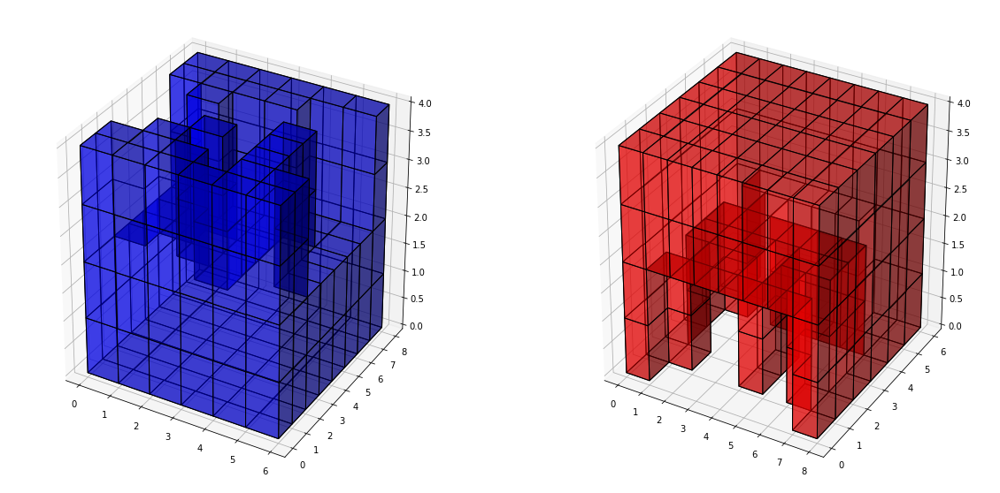

In [12]:
#@title Generate Candidate Solution 3D Matrix { form-width: "30%" }

def generate_candidate_sol(solution):
    """
    Given a solution configuration, generate a 3D array with bottom and top 
    fitted together 

    Input:
      - solution: one possible combination of blocks (list)
      
    Output:
      - candidate_sol: 3D array containing the candidate solution configuration,
        with bottom and top fitted together (numpy array)
      - block_number_to_letter: dictionary linking a unique number to each block
        of the configuration (dict)
      - block_letter_to_number: dictionary linking each block of the configuration
        to a unique number (dict)
      - bottom: 3D array containing the three bottom blocks stacked together (numpy array)
      - top_flipped_rotated: 3D array containing the three top blocks stacked together,
        flipped and rotated (numpy array)
    """
    # dictionary creation
    block_number_to_letter = {1:solution[0],2:solution[1],3:solution[2],
                              4:solution[3],5:solution[4],6:solution[5]}
    block_letter_to_number = {v:k for k,v in block_number_to_letter.items()}

    bottom = solution[:3]
    top = solution[3:]
    pieces_bottom = []
    block_number = 1
    for el in bottom:
        block = letter_to_piece[el].astype(int)
        block[letter_to_piece[el]==1] = block_number
        block_number += 1
        pieces_bottom.append(block)
    # stack together the 3 bottom blocks
    bottom = np.vstack((pieces_bottom[0], pieces_bottom[1], pieces_bottom[2]))
    pieces_top = []
    for el in top:
        block = letter_to_piece[el].astype(int)
        block[letter_to_piece[el]==1] = block_number
        block_number += 1
        pieces_top.append(block)
    # stack together the 3 top blocks
    top = np.vstack((pieces_top[0], pieces_top[1], pieces_top[2]))
    # flip and rotate the top
    top_flipped = np.flip(np.flip(top,1),2)
    top_flipped_rotated = np.rot90(top_flipped, k=1, axes=(1, 0))
    # create an empty space and fit together bottom and top
    zeros = np.zeros((8,8,6), dtype = int)
    zeros[1:-1,:,0:-2] = zeros[1:-1,:,0:-2] + bottom 
    zeros[:,1:-1,2:] = zeros[:,1:-1,2:] + top_flipped_rotated
    candidate_sol = zeros
    return candidate_sol, block_number_to_letter, block_letter_to_number, \
            bottom, top_flipped_rotated

# Let's try the newly defined function
solution = ['B', 'D', 'F', 'E', 'A', 'C']
candidate_sol, block_number_to_letter, block_letter_to_number, \
                    bottom, top_flipped_rotated = generate_candidate_sol(solution)
plot(bottom.astype(bool), top_flipped_rotated.astype(bool))

To better visualize the solutions, we assign a different color to each block. We wrap this operation in a function that provides the fancy plot

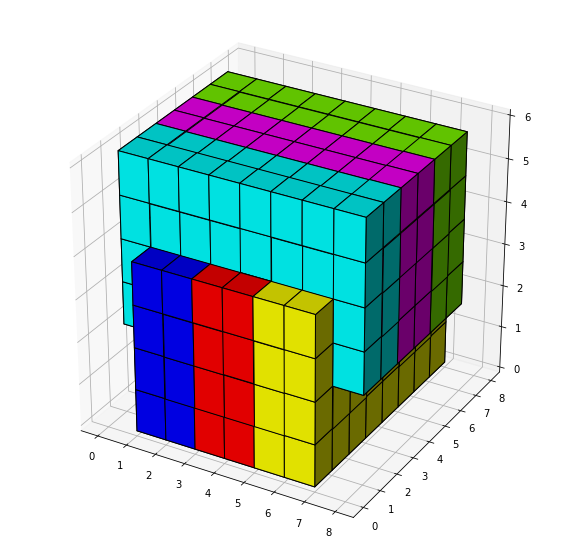

In [13]:
#@title Plot With Colors Function { form-width: "30%" }

def plot_with_colors(candidate_sol):
    """
    Given a 3D array of a candidate solution, plot it painting each block with a
    unique color 
    
    Input:
      - candidate_sol: 3D array of a candidate solution (numpy array)
    """
    if 7 not in candidate_sol:  # if the candidate_sol doesn't contain the outer box
        blocks_positions = [np.equal(candidate_sol,1),np.equal(candidate_sol,2),
                            np.equal(candidate_sol,3),np.equal(candidate_sol,4),
                            np.equal(candidate_sol,5),np.equal(candidate_sol,6)]
        colors = ["blue", "red", "yellow", "chartreuse", "magenta", "cyan"]
    else:  # assign a color also to the outer box
        blocks_positions = [np.equal(candidate_sol,1),np.equal(candidate_sol,2),
                            np.equal(candidate_sol,3),np.equal(candidate_sol,4),
                            np.equal(candidate_sol,5),np.equal(candidate_sol,6),
                            np.equal(candidate_sol,7)]
        colors = ["blue", "red", "yellow", "chartreuse", "magenta", "cyan", "bisque"]

    candidate_sol = candidate_sol.astype(bool)
    colors_candidate_sol = np.empty(candidate_sol.shape, dtype=object)
    for i in range(len(blocks_positions)):
        colors_candidate_sol[blocks_positions[i]] = colors[i]
    # plot everything
    fig = plt.figure(figsize=(10,10))
    ax = fig.gca(projection='3d')
    ax.voxels(candidate_sol, facecolors=colors_candidate_sol, edgecolor='k')
    plt.show()

plot_with_colors(candidate_sol)

Now that we have built the candidate solution and we are able to distinguish the single blocks, we need to enlarge the space, so that we will be able to move the blocks

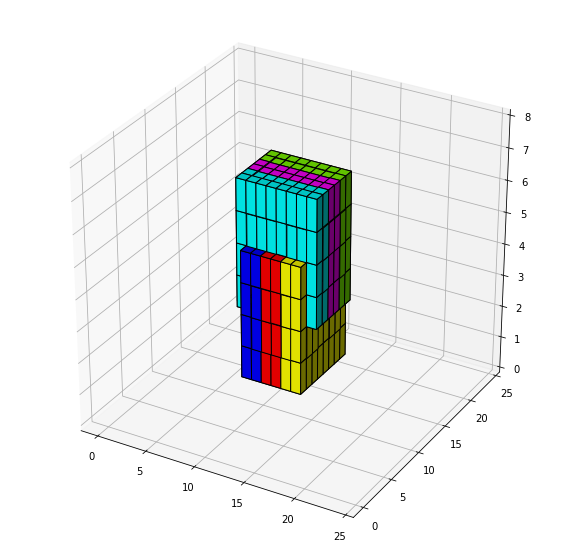

In [14]:
#@title Enlarge The 3D Space { form-width: "30%" }

resized_sol = np.zeros((24,24,8), dtype = int)
resized_sol[8:16,8:16,1:-1] = candidate_sol
plot_with_colors(resized_sol)

# <b>Box as 3D Matrix</b>

In this section we introduce the outer box in the 3D space

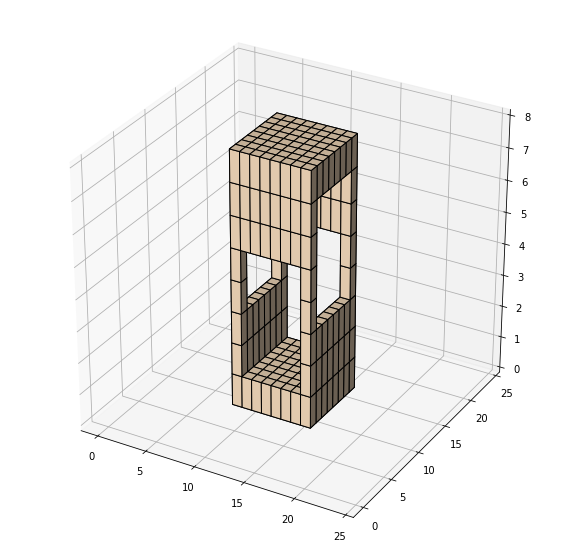

In [15]:
#@title Box Creation { form-width: "30%" }

# prepare some coordinates
x, y, z = np.indices((8, 8, 8))

# box
box = (z == 0) | (z == 7) | ((x == 0) & (y == 0)) | ((x == 0) & (y == 7)) | \
      ((x == 7) & (y == 0)) | ((x == 7) & (y == 7)) | ((x == 0) & (z > 4))| \
      ((x == 7) & (z > 4)) | ((y == 0) & (z < 3)) | ((y == 7) & (z < 3))

# enlarge the 3D space
resized_box = np.zeros((24,24,8), dtype = int)

# rotate the box
rotated90_box = np.rot90(box, k=1, axes=(1, 0))

# assign a unique number to the box
box_w_numbers = rotated90_box.astype(int)
box_w_numbers[box_w_numbers==1] = 7     # 1 to 6 for blocks, 7 for box 
resized_box[8:16,8:16,:] = box_w_numbers

# plot
plot_with_colors(resized_box)

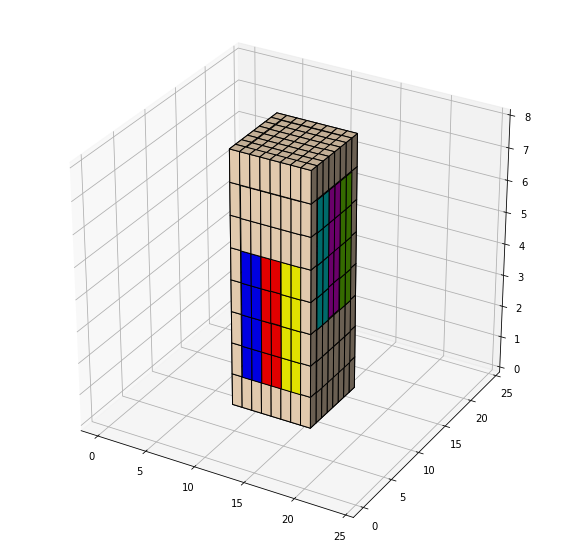

In [16]:
#@title Join Box And Blocks { form-width: "30%" }

box_and_blocks = resized_box + resized_sol
plot_with_colors(box_and_blocks)

#<b>Solving the Puzzle</b>

This is the main section of the notebook. Here we solve the puzzle employing a depth first search, and we define a simple heuristic to improve the efficiency. In order to obtain the best sequence of moves, we prune the ones that are useless.
<br>
<br>
We start in the next cells by defining a function to determine and execute all the possible moves that can be performed from a given configuration

In [17]:
#@title Compute Possible Moves Function { form-width: "30%" }

def possible_moves(resized_sol, block_letter = None, block_letter_to_number = None,
                   verbose = False, direction = None, block_number = None):
    """
    Given a 3D configuration, and a target block, return all the possible new 
    configurations reachable by moving it 
    
    Input:
      - resized_sol: 3D configuration of blocks (numpy array)
      - block_letter: label letter of the target block (string)
      - block_letter_to_number: dictionary linking each block of the configuration
        to a unique number (dict)
      - verbose: if True, print the possible moves for the target block,
        if False, remain silent (bool)
      - direction: one among ["up", "down", "left", "right"]. If a direction 
        is specified, try to move the target block only in that direction (string)
      - block_number: number of the target block (int)

    Output:
      - new_configurations: possible new configurations reachable by moving the 
        target block (list)
    """
    if not block_number:  # if the block number is not specified, use the letter
        block_number = block_letter_to_number[block_letter]

    # locate the block
    block_position = np.equal(resized_sol,block_number) 
    where_is_block = np.where(resized_sol==block_number)

    # try moving the block in the 4 possible directions
    rolled_up = np.roll(block_position, 1, axis=1)    # along y
    rolled_down = np.roll(block_position, -1, axis=1)
    rolled_left = np.roll(block_position, -1, axis=0)   # along x
    rolled_right = np.roll(block_position, 1, axis=0)

    resized_sol_without_block_to_move = copy.copy(resized_sol)
    resized_sol_without_block_to_move[where_is_block] = 0
    resized_sol_bool = resized_sol_without_block_to_move.astype(bool)

    new_configurations = []  # list of configurations reachable from the current one

    if direction == "up" or direction == None:
        temp_sol_up = resized_sol_bool.astype(int) + rolled_up.astype(int)  
        # the resulting matrix (temp_sol_up) contains only 0, 1 and 2 (if collision)
        can_move_up = 2 not in temp_sol_up
        if not can_move_up:  # maybe the block can push another block
            can_move_up, level_up, new_config = advanced_move(temp_sol_up, "up",
                                                              resized_sol, 
                                                              [block_number], 1)
            if can_move_up: new_configurations.append(new_config)
        else:  # if the block can freely move up
            rolled_up = rolled_up.astype(int)
            rolled_up[rolled_up == True] = block_number
            new_config = resized_sol_without_block_to_move + rolled_up
            new_configurations.append(new_config)
            level_up = 0  # 0 -> the block can move freely
    
    if direction == "down" or direction == None:
        temp_sol_down = resized_sol_bool.astype(int) + rolled_down.astype(int)
        can_move_down = 2 not in temp_sol_down
        if not can_move_down:
            can_move_down, level_down, new_config = advanced_move(temp_sol_down, "down", resized_sol, [block_number], 1)
            if can_move_down: new_configurations.append(new_config)
        else:
            rolled_down = rolled_down.astype(int)
            rolled_down[rolled_down == True] = block_number 
            new_config = resized_sol_without_block_to_move + rolled_down
            new_configurations.append(new_config)
            level_down = 0

    if direction == "left" or direction == None:
        temp_sol_left = resized_sol_bool.astype(int) + rolled_left.astype(int)
        can_move_left = 2 not in temp_sol_left
        if not can_move_left:
            can_move_left, level_left, new_config = advanced_move(temp_sol_left, "left", resized_sol, [block_number], 1)
            if can_move_left: new_configurations.append(new_config)
        else:
            rolled_left = rolled_left.astype(int)
            rolled_left[rolled_left == True] = block_number 
            new_config = resized_sol_without_block_to_move + rolled_left
            new_configurations.append(new_config)
            level_left = 0

    if direction == "right" or direction == None:
        temp_sol_right = resized_sol_bool.astype(int) + rolled_right.astype(int)
        can_move_right = 2 not in temp_sol_right
        if not can_move_right:
            can_move_right, level_right, new_config = advanced_move(temp_sol_right, "right", resized_sol, [block_number], 1)
            if can_move_right: new_configurations.append(new_config)
        else:
            rolled_right = rolled_right.astype(int)
            rolled_right[rolled_right == True] = block_number 
            new_config = resized_sol_without_block_to_move + rolled_right
            new_configurations.append(new_config)
            level_right = 0

    if direction:  
        # if a direction is specified, the new_configurations list will (possibly)
        # contain the new configuration reachable by performing a move along 
        # the specified direction
        return new_configurations
        
    can_move = [can_move_up, can_move_down, can_move_left, can_move_right]
    
    if True in can_move and verbose: 
        print("Block {0} can move: ".format(block_letter),end='')
        if can_move_up:
            print("up ",end='')
            print(level_up, end=' ')
        if can_move_down:
            print("down ",end='')
            print(level_down, end=' ')
        if can_move_left:
            print("left ", end='')
            print(level_left, end=' ')

        if can_move_right:
            print("right ", end='')
            print(level_right, end=' ')

    return new_configurations

The advanced_move() recursive function (that we define in the next cell) is called by possible_moves() (defined in the cell above) if a block can't move freely in one specified direction, to determine if the same block can move anyway in that direction by pushing one or more blocks

In [18]:
#@title Compute Advanced Moves Function { form-width: "30%" }

def advanced_move(temp_sol, direction, resized_sol, block_number_list, level):
    """
    Given a 3D configuration in which a block has been moved over another block
    (there is a collision), a direction of the performed move and the 3D 
    configuration before that move, return True if it is possible to perform the
    move by pushing other blocks (and also the corresponding resulting configuration) 
    
    Input:
      - temp_sol: 3D configuration containing the collision (numpy array)
      - direction: one among ["up", "down", "left", "right"]. This corresponds
        to the direction of the move that led to the current temp_sol (string)
      - resized_sol: 3D configuration before applying the move that led to
        collision (numpy array)
      - block_number_list: list containing the target blocks (list)
      - level: current level of the recursive call to this function (int)

    Output:
      - can_move_group: whether or not it is possible to move the target blocks
        in the specified direction (bool)
      - level: current level of the recursive call to this function (int)
      - new_config: new configuration reachable by moving the target blocks in 
        the specified direction (numpy array)
    """
    # identify where the collision happened
    collision_positions = np.equal(temp_sol,2)
    # identify the blocks involved in the collision
    collision_block_numbers = set(resized_sol[collision_positions])

    if 7 not in collision_block_numbers:  # no collision with the outer box
        blocks_to_move = copy.copy(collision_block_numbers)
        for el in block_number_list:
            blocks_to_move.add(el)
        temp = []
        for el in blocks_to_move:
            temp.append(np.equal(resized_sol,el))
        
        # identify the group of blocks that will be moved together inside the 
        # current configuration
        group_block_position = np.logical_or.reduce(temp)

        # perform the right move
        if direction == "up":
            rolled_group = np.roll(group_block_position, 1, axis=1)
        elif direction == "down":
            rolled_group = np.roll(group_block_position, -1, axis=1)
        elif direction == "left":
            rolled_group = np.roll(group_block_position, -1, axis=0)
        else:
            rolled_group = np.roll(group_block_position, 1, axis=0)
        resized_sol_without_group_block_to_move = copy.copy(resized_sol)
        temp = []

        # determine the coordinates of each block belonging to the group
        for el in blocks_to_move:
            temp.append(np.where(resized_sol==el))

        # stack together all the coordinates of blocks belonging to the group
        where_is_group_block = list(temp[0])
        for el in temp[1:]:
            where_is_group_block[0] = np.hstack((where_is_group_block[0],el[0]))  
            where_is_group_block[1] = np.hstack((where_is_group_block[1],el[1]))
            where_is_group_block[2] = np.hstack((where_is_group_block[2],el[2]))
        where_is_group_block = tuple(where_is_group_block)

        # remove the group block from the current configuration, in order to
        # move the group and add it back in the configuration next
        resized_sol_without_group_block_to_move[where_is_group_block] = 0
        resized_sol_bool_group = resized_sol_without_group_block_to_move.astype(bool)
        temp_sol_group = resized_sol_bool_group.astype(int) + rolled_group.astype(int)
        # the resulting matrix (temp_sol_group) contains only 0, 1 and 2 (if collision)
        can_move_group = 2 not in temp_sol_group

        if not can_move_group: # check if block group pushes other blocks
            level += 1  # increment the recursion level
            return advanced_move(temp_sol_group, direction, resized_sol,
                                 blocks_to_move, level)     # recursive call!

        else:   # solution found! Perform the move, 
                # compute the resulting configuration and return
            group_block_position = group_block_position.astype(int)  
            # in group_block_position we have only 0 and 1 (ones identify the group)    
            group_block = np.multiply(resized_sol, group_block_position)
            # in group_block we have only the blocks belonging to the group 
            # (with the corresponding numbers)  

            # let's perform the move and compute the resulting configuration
            if direction == "up":
                rolled_group = np.roll(group_block, 1, axis=1)
            elif direction == "down":
                rolled_group = np.roll(group_block, -1, axis=1)
            elif direction == "left":
                rolled_group = np.roll(group_block, -1, axis=0)
            else:
                rolled_group = np.roll(group_block, 1, axis=0)     
            new_config = resized_sol_without_group_block_to_move + rolled_group
            return can_move_group, level, new_config

    else:   # collision with the outer box -> it is not possible to perform
            # the specified move on the specified target blocks
        return False, -1, -1  # no solution found

Now that we have a way to define the feasible moves in a given configuration and also to compute the new configurations reachable, we define a recursive depth first search that explores the whole tree of configurations trying to find a solution. To improve and speed up the search algorithm we also define a heuristic that orders the nodes of the tree so that the ones that are more promising are explored first

In [19]:
#@title Check Block Extraction Function { form-width: "30%" }

def check_extraction(block_list,block_letter_to_number,configuration):
    """
    Check if a block was extracted from the box (and, in that case, remove it)
    
    Input:
      - block_list: list containing the target blocks labels (list)
      - block_letter_to_number: dictionary linking each block of the configuration
        to a unique number (dict)
      - configuration: 3D configuration of blocks and box (numpy array)

    Output:
      - configuration: updated 3D configuration of blocks and box (numpy array)
      - new_block_list: updated list containing the target blocks labels (list)
    """
    new_block_list = []
    # check if one of the blocks in the current configuration was extracted from the box
    for el in block_list: 
        block_number = block_letter_to_number[el]
        where_is_block = np.where(configuration==block_number) # x and y and z coordinates
        coord = np.unique(where_is_block[1]) if len(np.unique(where_is_block[0]))==2 \
                                             else np.unique(where_is_block[0])
        if coord[0] == 0 or coord[0] == 16:     # block extracted
            configuration[where_is_block] = 0   # remove the block
        else:   # block not extracted
            new_block_list.append(el)

    return configuration, new_block_list

In [20]:
#@title Heuristic Definition { form-width: "30%" }

def order_configurations(new_configurations):   
    """
    Heuristic to order the configurations in a list, by placing first 
    configurations in which blocks are more outside of the box. This is useful 
    to speed up the depth first search (and find better solutions!)
    
    Input:
      - new_configurations: list containing 3D arrays of configurations to be
        ordered (list)

    Output:
      - new_configurations: updated list containing the ordered 3D arrays of
        configurations (list)
    """
    to_order = []
    for configuration in new_configurations: 
        # reset the points inside the box in the current configurations
        config_without_inner_points = copy.copy(configuration)
        config_without_inner_points[8:16,8:16,:] = np.zeros((8,8,8), dtype = int)
        config_without_inner_points = config_without_inner_points.astype(bool)

        # count how many points outside the box (at z = 1 and z = 6) are
        # filled by a block
        n_points_outside_box = np.sum(config_without_inner_points[:,:,1]) \
                             + np.sum(config_without_inner_points[:,:,6])
        to_order.append(n_points_outside_box)

    # now let's order the configurations: we will place first the ones with
    # more points already outside the box
    new_configurations = [x for _,x in sorted(zip(to_order,new_configurations),
                                              key = lambda t: t[0],reverse=True)]
    return new_configurations

In [21]:
#@title Depth First Search Function { form-width: "30%" }

def recursive_depth_first_search(config, block_list, path, block_letter_to_number,
                                 target, solution_steps, block_to_remove = None, 
                                 block_to_remove_direction = None,
                                 sol_for_animation = True): 
    """
    Perform a recursive depth first search, exploring the whole tree of
    configurations until a solution (empty box) is found, otherwise fail

    Input:
      - config: 3D configuration of blocks and box (numpy array)
      - block_list: list containing the target blocks labels (list)
      - path: list keeping track of all the already explored configurations (list)
      - block_letter_to_number: dictionary linking each block of the configuration
        to a unique number (dict)
      - target: 3D configuration corresponding to the empty box only. This is 
        the target configuration we want to reach, in which case we found
        a solution (numpy array)
      - solution_steps: list containing the steps (consecutive configurations)
        to reach the solution (list)
      - block_to_remove: label of the block that can be removed starting from 
        the current config. This parameter is None by default and will be handled
        by the algorithm (string)
      - block_to_remove_direction: direction in which the block_to_remove should
        be moved in order to extract it from the box. This parameter is None by 
        default and will be handled by the algorithm (string)
      - sol_for_animation: if True, produce a solution that is suitable for 
        visualization purposes, else just find the faster solution (bool)

    Output:
      - outcome: outcome of the depth first search -> True if a solution has been
        found, false otherwise (bool)
    """
    # check if the current configuration hasn't already been explored 
    if not(any((config == x).all() for x in path)) or \
        (sol_for_animation and block_to_remove):
        path.append(config)  # add the current configuration to the path

        if block_to_remove:   # if there is a block that can be extracted, do it!
            # perform the move on the specified block in the right direction
            configuration = possible_moves(config, block_to_remove,
                                           block_letter_to_number, 
                                           direction = block_to_remove_direction)[0]

            # check if a block can be removed                              
            configuration, new_block_list = check_extraction(block_list,
                                                             block_letter_to_number,
                                                             configuration)

            if (configuration == target).all():    # if solution found
                solution_steps.append(configuration)
                return True

            if block_to_remove not in new_block_list:   # block extracted
                outcome = recursive_depth_first_search(configuration, new_block_list,
                                                       path, block_letter_to_number,
                                                       target, solution_steps,
                                                       sol_for_animation = sol_for_animation)
            else:   # block still not extracted
                outcome = recursive_depth_first_search(configuration, block_list,
                                                       path, block_letter_to_number,
                                                       target, solution_steps,
                                                       block_to_remove,
                                                       block_to_remove_direction,
                                                       sol_for_animation = sol_for_animation)
                       
            if outcome:  # when a solution is found, outcome becomes True and
                         # all the recursive calls leading to the solution
                         # will need to add the corresponding configuration
                         # to the solution_steps list
                solution_steps.append(configuration)
                return outcome

        for el in block_list:
            # get all the possible configurations reachable from the current 
            # configuration by moving a block
            new_configurations = possible_moves(config, el, block_letter_to_number)

            # if we have more than one new configuration, then it makes sense to
            # leverage on the heuristic to explore the most promising ones first
            if len(new_configurations) > 1:
                # sort the configurations
                new_configurations = order_configurations(new_configurations)

                # let's check if there is a configuration in which a block 
                # can be extracted
                for configuration in new_configurations:   
                    for el in block_list:   # if we can extract a block, 
                                            # then this is the best move. We will
                                            # choose this configuration first!
                        block_number = block_letter_to_number[el]
                        where_is_block = np.where(configuration==block_number)
                        x_coord_unique = np.unique(where_is_block[0])
                        y_coord_unique = np.unique(where_is_block[1])
                        z_coord_unique = np.unique(where_is_block[2])
                        if len(x_coord_unique) == 8:  # if block is arranged 
                                                      # along x dimension
                            area_of_interest = configuration[:,y_coord_unique,
                                                             z_coord_unique[0]:
                                                             z_coord_unique[3]+1]
                            # area_of_interest is the portion of the 3D matrix 
                            # in which the target block should move in order to 
                            # be extracted from the box
                            configuration_direction = "right"  # to obtain a clear animation
                        else:   # block is arranged along y dimension
                            area_of_interest = configuration[x_coord_unique,:,
                                                             z_coord_unique[0]:
                                                             z_coord_unique[3]+1]
                            configuration_direction = "down"  # to obtain a clear animation
                        
                        # compute how many blocks there are in the area of interest
                        n_blocks_in_area = np.unique(area_of_interest)[1:]
                        # if there's only the target block in the area of interest
                        if len(n_blocks_in_area) == 1:  # we can extract the block!
                            # set the fastest direction to remove the block 
                            # (we will do this only if we aren't interested in 
                            # obtaining a solution that is optimized for visualization)
                            if not sol_for_animation:
                                if len(x_coord_unique) == 8 and x_coord_unique[0]<=8:
                                    configuration_direction = "left" 
                                elif len(x_coord_unique) == 8 and x_coord_unique[0]>8:
                                    configuration_direction = "right" 
                                elif y_coord_unique[0]<=8:
                                    configuration_direction = "down"
                                else:
                                    configuration_direction = "up"

                            # recursive call to extract the block
                            outcome = recursive_depth_first_search(configuration,
                                                                   block_list, path,
                                                                   block_letter_to_number,
                                                                   target, solution_steps,
                                                                   el, configuration_direction,
                                                                   sol_for_animation = sol_for_animation)
                            if outcome:
                                solution_steps.append(configuration)
                                return outcome 

            for configuration in new_configurations:
                # check if a block can be removed                              
                configuration, block_list = check_extraction(block_list,
                                                             block_letter_to_number,
                                                             configuration)
                # recursive call               
                outcome = recursive_depth_first_search(configuration, block_list,
                                                       path, block_letter_to_number,
                                                       target, solution_steps,
                                                       sol_for_animation = sol_for_animation)
                if outcome:
                    solution_steps.append(configuration)
                    return outcome

In [22]:
#@title Increase Recursion Limit { form-width: "30%" }

import sys 
sys.setrecursionlimit(3000)  # in order to be able to explore the full tree reaching 
                             # the leaves, we need to increase the recursion limit

The next cell is the one that actually performs the full depth first search and finds the solutions

In [23]:
#@title Compute Final Solutions { form-width: "30%" }

from tqdm.notebook import tqdm  # for setting up a fancy progress bar!

target = resized_box  # our target is the empty box
count_solutions = 0  # keeps track of how many solutions have been found
true_solutions = []  # will contain all the block labels sequences that are  
                     # actually a solution of this puzzle
all_solution_steps = []  # will contain all the steps (sequence of 3D 
                         # configurations) for each found solution

# we know that being a possible solution is a necessary condition to be a true
# solution, thus we will perform the depth first search only on the possible solutions
for possible_solution in tqdm(solutions):
    # generate the 3D array corresponding to the possible_solution
    candidate_sol, _, block_letter_to_number, _, _ = generate_candidate_sol(possible_solution)
    resized_sol = np.zeros((24,24,8), dtype = int)
    resized_sol[8:16,8:16,1:-1] = candidate_sol
    box_and_blocks = resized_box + resized_sol

    path = []
    solution_steps = []
    # start the depth first search on the current possible solution
    is_sol_found = recursive_depth_first_search(box_and_blocks, possible_solution, 
                                                path, block_letter_to_number, target, 
                                                solution_steps, sol_for_animation = True)
    solution_steps.append(box_and_blocks)
    if is_sol_found:  # if solution found
        all_solution_steps.append(solution_steps)  # append the steps of the current solution
        count_solutions += 1
        true_solutions.append(possible_solution)  # append the current solution configuration
        print(f"\nSOLUTION FOUND: {possible_solution} ---- Solution counter: {count_solutions}")


SOLUTION FOUND: ['c', 'a', 'b', 'f', 'd', 'e'] ---- Solution counter: 1

SOLUTION FOUND: ['A', 'C', 'b', 'f', 'D', 'e'] ---- Solution counter: 2

SOLUTION FOUND: ['A', 'C', 'b', 'f', 'e', 'D'] ---- Solution counter: 3

SOLUTION FOUND: ['A', 'C', 'D', 'f', 'e', 'b'] ---- Solution counter: 4

SOLUTION FOUND: ['A', 'D', 'b', 'f', 'C', 'e'] ---- Solution counter: 5

SOLUTION FOUND: ['A', 'D', 'b', 'f', 'e', 'C'] ---- Solution counter: 6

SOLUTION FOUND: ['A', 'D', 'C', 'f', 'e', 'b'] ---- Solution counter: 7

SOLUTION FOUND: ['a', 'd', 'F', 'B', 'c', 'e'] ---- Solution counter: 8

SOLUTION FOUND: ['A', 'd', 'F', 'B', 'c', 'e'] ---- Solution counter: 9

SOLUTION FOUND: ['A', 'e', 'C', 'B', 'D', 'F'] ---- Solution counter: 10

SOLUTION FOUND: ['a', 'E', 'C', 'f', 'd', 'b'] ---- Solution counter: 11

SOLUTION FOUND: ['A', 'E', 'C', 'f', 'd', 'b'] ---- Solution counter: 12

SOLUTION FOUND: ['a', 'E', 'D', 'f', 'c', 'b'] ---- Solution counter: 13

SOLUTION FOUND: ['A', 'E', 'D', 'f', 'c', 'b']

Now that we have all the true solutions and the corresponding sequence of steps, we implement a function to possibly reduce the number of steps. In particular, the function defined in the next cell will prune all the useless steps in a solution, by trying to find shortcuts

In [24]:
#@title Pruning Function { form-width: "30%" }

def prune_useless_steps(solution_steps):
    """
    Given the steps of a solution, try to find an improved (shorter) sequence of
    steps for the same solution by pruning useless steps 
    
    Input:
      - solution_steps: sequence of 3D configurations for a particular solution
        (list)

    Output:
      - pruned_solution_steps: updated list containing the pruned sequence of
        3D configurations (list)
    """    
    pruned_solution_steps = []   # will contain the pruned sequence
    sol_steps = copy.copy(solution_steps)
    for config_idx, config in enumerate(sol_steps):
        pruned_solution_steps.append(config)
        shortcuts = {}

        # iterate on block numbers in the current configuration
        for block_number in np.unique(config)[1:-1]:
            # evaluate the configurations reachable from the current configuration
            # by moving the selected block  
            poss_moves = possible_moves(config, block_number = block_number)

            # for each new reachable configuration
            for new_config in poss_moves:
                # check if the selected new configuration matches one of the future
                # steps in solution_steps. In that case we found a shortcut and
                # we can go straight to that step from the current configuration,
                # skipping everything in between
                for idx, future_step in enumerate(sol_steps[config_idx+2:]):
                    if (new_config == future_step).all():
                        shortcuts[idx] = new_config

        # if at least one shortcut was found, take the best one (the one that skips
        # more steps)
        if len(shortcuts) > 0:
            pruned_solution_steps.append(shortcuts[max(shortcuts)])
            # delete from solution steps the configurations that were skipped
            del sol_steps[config_idx+1:config_idx+3+max(shortcuts)] 

    return pruned_solution_steps

In [25]:
#@title Prune Useless Steps { form-width: "30%" }

# Prune all the useless steps in the solutions
all_solution_steps_pruned = []
for i,solution_steps in enumerate(all_solution_steps):
    all_solution_steps_pruned.append(prune_useless_steps(solution_steps))

# How many steps are there in each solution before and after pruning? Let's find out!
print("Steps in each solution before pruning: ")
for el in all_solution_steps:
    print(len(el), end = " ")
print()
print()
print("Steps in each solution after pruning: ")
for el in all_solution_steps_pruned:
    print(len(el), end = " ")

Steps in each solution before pruning: 
144 122 122 110 94 125 97 143 123 570 273 177 306 181 309 99 340 132 83 84 125 128 80 131 235 83 105 81 115 197 173 121 473 181 354 845 

Steps in each solution after pruning: 
78 92 86 91 80 93 81 92 75 83 91 80 99 84 130 66 115 79 63 68 80 74 65 74 82 63 65 69 71 94 75 72 106 108 101 111 

# <b>Animation Creation</b>

In this section we create fancy animations for each final solution, so that the steps are easily understandable and can be reproduced on the physical puzzle

In [26]:
#@title Add Steps For Animation Function { form-width: "30%" }

def add_intermediate_steps(solution_steps, sol_for_animation = False):   
    """
    Add some steps to a given solution so that the corresponding animation will 
    be more clear: in particular blocks will be placed outside of the plot and 
    will gradually appear step by step 
    
    Input:
      - solution_steps: sequence of 3D configurations for a particular solution
        (list)
      - sol_for_animation: if True, add some steps so that the updated solution 
        is suitable for visualization purposes (bool)

    Output:
      - new_solution_steps: updated list containing the enriched sequence of
        3D configurations (list)
    """
    new_solution_steps = []
    for config_idx in range(len(solution_steps)-1):     
        new_solution_steps.append(solution_steps[config_idx])
        if np.sum(np.unique(solution_steps[config_idx])) != np.sum(
            np.unique(solution_steps[config_idx+1])):  # if a new block will appear
                                                       # in the next configuration
            # identify the new block 
            new_block = np.sum(np.unique(solution_steps[config_idx+1])) \
                        - np.sum(np.unique(solution_steps[config_idx]))
            # x and y and z coordinates of the new block
            where_is_block = np.where(solution_steps[config_idx+1]==new_block) 
            x_coord_unique = np.unique(where_is_block[0])
            y_coord_unique = np.unique(where_is_block[1])
            z_coord_unique = np.unique(where_is_block[2])    

            # in order to make the block gradually appear, we need to define a
            # larger empty space. The block will move in this new space, and a 
            # portion of it will gradually become visible in the current configuration
            empty_space = np.zeros((40,40,8), dtype=int)
            
            temp = []  # temp will possibly contain some additional steps that
                       # will be added to the solution and will make it
                       # more suited for visualization purposes

            # now we need to understand in which direction the block has to move
            if len(x_coord_unique) == 8 and x_coord_unique[0]<=12:
                # in this case we want to insert the block from the left of the box...
                # ...if our goal is to create an animation, we compute some additional steps
                # so that the animation will be more clear (otherwise the block
                # won't be fully visible in the plot since it will be covered by the box)
                if sol_for_animation:
                    new_step = possible_moves(solution_steps[config_idx+1], 
                                              direction = "left",
                                              block_number = new_block)[0]
                    temp.append(new_step)
                    if y_coord_unique[0]<=12:
                        while np.where(temp[-1]==new_block)[1][0] != 2:
                            new_step = possible_moves(temp[-1], 
                                                      direction = "down",
                                                      block_number = new_block)[0]
                            temp.append(new_step)   
                    else:
                        while np.where(temp[-1]==new_block)[1][0] != 20:
                             new_step = possible_moves(temp[-1], 
                                                      direction = "up",
                                                      block_number = new_block)[0]
                             temp.append(new_step)
                    while np.where(temp[-1]==new_block)[0][0] != 15:
                            new_step = possible_moves(temp[-1], 
                                                      direction = "right",
                                                      block_number = new_block)[0]
                            temp.append(new_step) 
                    configuration_direction = "left"
                    where_is_block = np.where(temp[-1]==new_block) 
                    x_coord_unique = np.unique(where_is_block[0])
                    y_coord_unique = np.unique(where_is_block[1])
                    z_coord_unique = np.unique(where_is_block[2]) 
                    # add the new block to the empty space
                    empty_space[32:,y_coord_unique+8,z_coord_unique[0]:z_coord_unique[3]+1] = \
                                temp[-1][15:23,y_coord_unique,z_coord_unique[0]:z_coord_unique[3]+1]
                    empty_space_w_block = empty_space
                else:
                    configuration_direction = "right"
                    empty_space[0:8,y_coord_unique+8,z_coord_unique[0]:z_coord_unique[3]+1] = \
                                solution_steps[config_idx+1][1:9,y_coord_unique,
                                                            z_coord_unique[0]:
                                                            z_coord_unique[3]+1]
                    empty_space_w_block = empty_space
            elif len(x_coord_unique) == 8 and x_coord_unique[0]>12:
                configuration_direction = "left"
                empty_space[32:,y_coord_unique+8,z_coord_unique[0]:z_coord_unique[3]+1] = \
                            solution_steps[config_idx+1][15:23,y_coord_unique,
                                                         z_coord_unique[0]:
                                                         z_coord_unique[3]+1]
                empty_space_w_block = empty_space
            elif y_coord_unique[0]<=8:
                configuration_direction = "up"
                empty_space[x_coord_unique+8,0:8,z_coord_unique[0]:z_coord_unique[3]+1] = \
                            solution_steps[config_idx+1][x_coord_unique,1:9,
                                                         z_coord_unique[0]:
                                                         z_coord_unique[3]+1]
                empty_space_w_block = empty_space
            else:
                # in this case we want to insert the block from the back of the box...
                # ...if our goal is to create an animation, we compute some additional steps
                # so that the animation will be more clear (otherwise the block
                # won't be fully visible in the plot since it will be covered by the box)
                if sol_for_animation:                    
                    new_step = possible_moves(solution_steps[config_idx+1], 
                                              direction = "up",
                                              block_number = new_block)[0]
                    temp.append(new_step)
                    if x_coord_unique[0]<=12:
                        while np.where(temp[-1]==new_block)[0][0] != 2:
                            new_step = possible_moves(temp[-1], 
                                                      direction = "left",
                                                      block_number = new_block)[0]
                            temp.append(new_step)   
                    else:
                        while np.where(temp[-1]==new_block)[0][0] != 20:
                             new_step = possible_moves(temp[-1], 
                                                      direction = "right",
                                                      block_number = new_block)[0]
                             temp.append(new_step)
                    while np.where(temp[-1]==new_block)[1][0] != 1:
                            new_step = possible_moves(temp[-1], 
                                                      direction = "down",
                                                      block_number = new_block)[0]
                            temp.append(new_step) 
                    configuration_direction = "up"
                    where_is_block = np.where(temp[-1]==new_block) 
                    x_coord_unique = np.unique(where_is_block[0])
                    y_coord_unique = np.unique(where_is_block[1])
                    z_coord_unique = np.unique(where_is_block[2]) 
                    empty_space[x_coord_unique+8,0:8,z_coord_unique[0]:z_coord_unique[3]+1] = \
                                temp[-1][x_coord_unique,1:9,z_coord_unique[0]:z_coord_unique[3]+1]
                    empty_space_w_block = empty_space
                else:
                    configuration_direction = "down"
                    empty_space[x_coord_unique+8,32:,z_coord_unique[0]:z_coord_unique[3]+1] = \
                                solution_steps[config_idx+1][x_coord_unique,15:23,
                                                            z_coord_unique[0]:
                                                            z_coord_unique[3]+1]
                    empty_space_w_block = empty_space
            
            for i in range(8):  # add 8 steps to the solution so that the block 
                                # will appear gradually
                new_step = possible_moves(empty_space_w_block, 
                                          direction = configuration_direction,
                                          block_number = new_block)[0]
                empty_space_w_block = new_step
                new_step = new_step[8:32,8:32,:] + solution_steps[config_idx]
                new_solution_steps.append(new_step)
                
            if temp:
                new_solution_steps += temp[::-1]  # add the additional steps computed
                                                  # for visualization purposes

    # append the last configuration
    new_solution_steps.append(solution_steps[config_idx+1])
    return new_solution_steps

In [27]:
#@title Matplotlib Configuration { form-width: "30%" }

from matplotlib import rc
rc('animation', html='jshtml')
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

In [28]:
#@title Create Animation Function { form-width: "30%" }

import mpl_toolkits.mplot3d.axes3d as p3
import matplotlib.animation as animation

def create_animation(solution_steps):
    """
    Given the sequence of steps of a solution, create the corresponding 
    animation (in which each step is a frame)
    
    Input:
      - solution_steps: sequence of 3D configurations for a particular solution
        (list)

    Output:
      - steps_animation: animation object (matplotlib.animation.FuncAnimation)
    """
    # Attaching 3D axis to the figure
    fig = plt.figure(figsize=(8,8))
    ax = p3.Axes3D(fig)

    def update_steps(num, solution_steps):
        """
        Given the frame number and the sequence of steps of a solution, 
        return a figure containing the updated frame
        
        Input:
        - num: frame number (int)
        - solution_steps: sequence of 3D configurations for a particular solution
                          (list)

        Output:
        - fig: figure containing the updated frame (matplotlib.figure.Figure)
        """
        ax.clear()  # clear the axes
        step = solution_steps[num]   # extract the current step
        # identify the block positions in the current step (this is useful to 
        # attribute a color to each block)
        blocks_positions = [np.equal(step,1),np.equal(step,2),
                            np.equal(step,3),np.equal(step,4),
                            np.equal(step,5),np.equal(step,6), 
                            np.equal(step,7)]  
        colors = ["blue", "red", "yellow", "chartreuse", "magenta", "cyan", "bisque"]
        step_w_numbers = copy.copy(step)
        step = step.astype(bool)
        colors_step= np.empty(step.shape, dtype=object)
        for i in range(len(blocks_positions)):  # assign a color to each block
            colors_step[blocks_positions[i]] = colors[i]
        # plot a set of filled voxels
        ax.voxels(step, facecolors=colors_step, edgecolor='k')
        return fig

    # Creating the Animation object
    steps_animation = animation.FuncAnimation(fig, update_steps, fargs=(solution_steps,),
                                frames=len(solution_steps), interval=300, blit=False)
    plt.close()
    return steps_animation

Now that we have defined a function to return an animation object, we can try it. The creation of the animation is a quite expensive operation, so, for time reasons, we plot only the shortest solution available (the one with the smallest number of steps). Then, by running the following cells, the reader will be able to create and save the animations of all the solutions

In [29]:
#@title Animate The Shortest Solution { form-width: "30%" }

# find the index of the shortest sol
shortest_sol_index = np.argmin([len(solution_steps) for solution_steps 
                                in all_solution_steps_pruned])
# prune useless steps
solution_steps_pruned = all_solution_steps_pruned[shortest_sol_index] 
# add intermediate steps
new_solution_steps_pruned = add_intermediate_steps(solution_steps_pruned, sol_for_animation = True)

print(f"The shortest solution available is {true_solutions[shortest_sol_index]}"
      f" and consists of {len(new_solution_steps_pruned)} steps\n")
steps_animation = create_animation(new_solution_steps_pruned)
steps_animation     # display the animation

The shortest solution available is ['B', 'C', 'F', 'd', 'e', 'a'] and consists of 111 steps



In [30]:
#@title Save Animation as .GIF { form-width: "30%" }

# Save the animation displayed above as a GIF in the local environment
writergif = animation.PillowWriter(fps=5)  # 5 frames per second
pbar = tqdm(total=len(new_solution_steps_pruned))  # progress bar
steps_animation.save(f'{true_solutions[shortest_sol_index]}_{len(new_solution_steps_pruned)}_steps.gif',
                     writer=writergif, progress_callback=lambda i, n: pbar.update(1))
pbar.close()

In [31]:
#@title Save All Animations { form-width: "30%" }

# Save the animations of all the solutions in a local folder 
# (CAUTION: this will take some time!)
import os.path

# create a target folder if it doesn't exist
path = "./Chinese Cube Solutions"
if not os.path.exists(path):
    os.mkdir(path)

for i,solution_steps in enumerate(all_solution_steps_pruned):
    print(f"Saving solution {i+1} of {len(all_solution_steps)}...")
    solution = true_solutions[i]
    # add intermediate steps
    new_solution_steps = add_intermediate_steps(solution_steps, sol_for_animation = True)
    steps_animation = create_animation(new_solution_steps)
    writergif = animation.PillowWriter(fps=5) 
    pbar = tqdm(total=len(new_solution_steps))  # progress bar
    steps_animation.save(f'{path}/{solution}_{len(new_solution_steps)}_steps.gif',
                         writer=writergif, progress_callback=lambda i, n: pbar.update(1))
    pbar.close()

Saving solution 1 of 36...



Saving solution 2 of 36...



Saving solution 3 of 36...



Saving solution 4 of 36...



Saving solution 5 of 36...



Saving solution 6 of 36...



Saving solution 7 of 36...



Saving solution 8 of 36...



Saving solution 9 of 36...



Saving solution 10 of 36...



Saving solution 11 of 36...



Saving solution 12 of 36...



Saving solution 13 of 36...



Saving solution 14 of 36...



Saving solution 15 of 36...



Saving solution 16 of 36...



Saving solution 17 of 36...



Saving solution 18 of 36...



Saving solution 19 of 36...



Saving solution 20 of 36...



Saving solution 21 of 36...



Saving solution 22 of 36...



Saving solution 23 of 36...



Saving solution 24 of 36...



Saving solution 25 of 36...



Saving solution 26 of 36...



Saving solution 27 of 36...



Saving solution 28 of 36...



Saving solution 29 of 36...



Saving solution 30 of 36...



Saving solution 31 of 36...



Saving solution 32 of 36...



Saving solution 33 of 36...



Saving solution 34 of 36...



Saving solution 35 of 36...



Saving solution 36 of 36...
